In [6]:
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from glob import glob
from ipywidgets import interactive
import ipywidgets as widgets
from IPython.display import HTML

In [7]:
def rgb_to_grayscale(image):
    """Convert an RGB image to grayscale."""
    return np.dot(image[..., :3], [0.2989, 0.5870, 0.1140])


def load_and_stack_slices(slice_paths):
    """Load slices, convert them to grayscale if they are RGB, and stack into a 3D array."""
    slices = []
    for path in slice_paths:
        img = np.array(Image.open(path))
        if img.ndim == 3 and img.shape[2] == 3:  # Check if the image is RGB
            img = rgb_to_grayscale(img)
        slices.append(img)
    return np.stack(slices, axis=-1)


def create_3d_volumes(base_dir, output_dir, num_slices=61):
    """Create 3D volumes by grouping every 'num_slices' images as one patient's data set."""
    class_folders = [os.path.join(base_dir, d) for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))]

    for class_folder in class_folders:
        for root, dirs, files in os.walk(class_folder):
            files.sort(reverse=True)  # Sort to maintain the correct top-to-bottom anatomical order

            patient_count = 0
            for i in range(0, len(files), num_slices):
                if i + num_slices > len(files):
                    break

                slice_paths = [os.path.join(root, files[j]) for j in range(i, i + num_slices)]
                volume = load_and_stack_slices(slice_paths)

                output_class_dir = os.path.join(output_dir, os.path.basename(class_folder))
                if not os.path.exists(output_class_dir):
                    os.makedirs(output_class_dir)

                output_filepath = os.path.join(output_class_dir, f"patient_{patient_count:04d}_3D.npy")
                np.save(output_filepath, volume)
                print(f"Saved grayscale 3D volume to {output_filepath}")
                patient_count += 1

In [8]:
base_dir = 'filtered_dataset'
output_dir = '3D_dataset'

In [9]:
create_3d_volumes(base_dir, output_dir)

Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0000_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0001_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0002_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0003_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0004_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0005_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0006_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0007_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0008_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0009_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0010_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0011_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0012_3D.npy
Saved grayscale 3D volume to 3D_dataset\Dementia\patient_0013_3D.npy
Saved grayscale 3D volume to 3D_da

In [10]:
def load_npy_volume(path):
    volume = np.load(path)
    print(f"Loaded 3D volume with shape: {volume.shape}")
    return volume


def animate_axial(volume, gif_path, interval=50):
    """
    Animate axial slices of the 3D volume and save as a GIF file.
    """
    fig, ax = plt.subplots(figsize=(10, 5))

    def update(slice_idx):
        ax.clear()
        ax.imshow(volume[:, :, slice_idx], cmap="gray")
        ax.set_title(f"Axial Slice at Z={slice_idx}")
        ax.axis("off")

    anim = FuncAnimation(fig, update, frames=volume.shape[2], interval=interval)

    # Save the animation as a GIF
    anim.save(gif_path, writer="imagemagick", dpi=80)
    print(f"Saved animation to {gif_path}")

    return HTML(anim.to_jshtml())

MovieWriter imagemagick unavailable; using Pillow instead.


Loaded 3D volume with shape: (248, 496, 61)
Saved animation to 3D_sample_Demented.gif


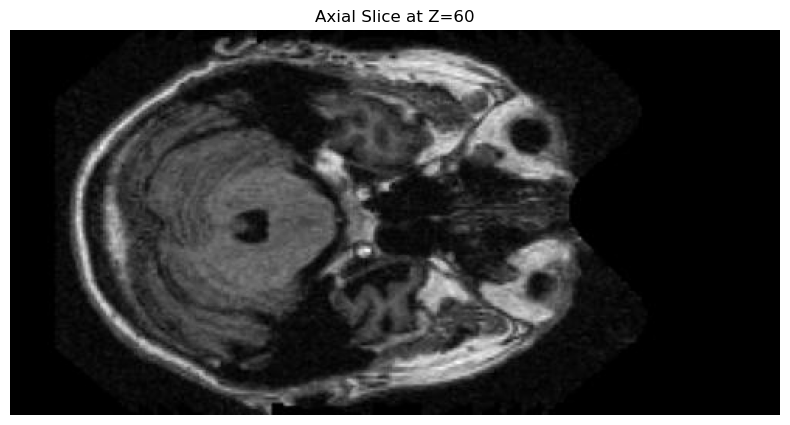

In [11]:
# Load demented volume
path_to_npy = "3D_dataset/Dementia/patient_0000_3D.npy"
volume = load_npy_volume(path_to_npy)

# Save the animation as a GIF
animate_axial(volume, '3D_sample_Demented.gif')

MovieWriter imagemagick unavailable; using Pillow instead.


Loaded 3D volume with shape: (248, 496, 61)
Saved animation to 3D_sample_Undemented.gif


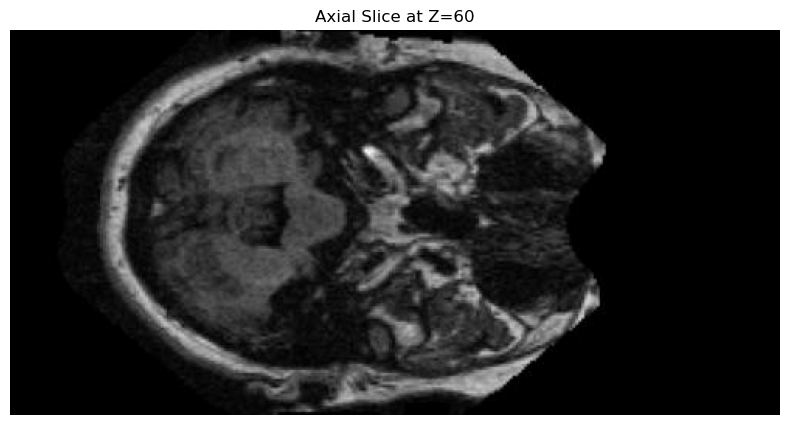

In [12]:
# Load undemented volume
path_to_npy = "3D_dataset/Not Dementia/patient_0000_3D.npy"
volume = load_npy_volume(path_to_npy)

# Save the animation as a GIF
animate_axial(volume, '3D_sample_Undemented.gif')